<center><img src="https://github.com/hse-ds/iad-applied-ds/blob/master/2021/hw/hw1/img/logo_hse.png?raw=1" width="1000"></center>

<h1><center>Прикладные задачи анализа данных</center></h1>
<h2><center>Домашнее задание 3: прогнозирование временных рядов</center></h2>

**Мягкий дедлайн:** 23:59MSK 19.05.2024

**Жесткий дедлайн:** 23:59MSK 26.05.2024

In [1]:
!pip install -r requirements.txt

In [2]:
import warnings
import gdown
import pandas as pd
import numpy as np
from copy import deepcopy

from etna.analysis import cross_corr_plot
from etna.analysis import distribution_plot
from etna.analysis import plot_anomalies
from etna.analysis import plot_anomalies_interactive
from etna.analysis import plot_backtest
from etna.analysis import plot_correlation_matrix
from etna.analysis import plot_forecast
from etna.analysis import acf_plot
from etna.analysis import stl_plot
from etna.analysis.outliers import get_anomalies_density
from etna.analysis.outliers import get_anomalies_hist
from etna.analysis.outliers import get_anomalies_median
from etna.analysis.outliers import get_anomalies_prediction_interval
from etna.datasets import TSDataset
from etna.ensembles import DirectEnsemble, StackingEnsemble, VotingEnsemble
from etna.metrics import MAE, MAPE, MSE, SMAPE
from etna.models import CatBoostPerSegmentModel
from etna.models import CatBoostMultiSegmentModel
from etna.models import LinearPerSegmentModel
from etna.models import MovingAverageModel
from etna.models import NaiveModel
from etna.models import AutoARIMAModel
from etna.models import ProphetModel
from etna.models import SeasonalMovingAverageModel
from etna.pipeline import AutoRegressivePipeline, Pipeline, assemble_pipelines
from etna.transforms import DateFlagsTransform
from etna.transforms import FilterFeaturesTransform
from etna.transforms import HolidayTransform
from etna.transforms import LagTransform
from etna.transforms import LinearTrendTransform
from etna.transforms import LogTransform
from etna.transforms import MeanTransform
from etna.transforms import MedianOutliersTransform
from etna.transforms import SegmentEncoderTransform
from etna.transforms import TimeSeriesImputerTransform
from etna.datasets import load_dataset

warnings.filterwarnings("ignore")

В данной задаче мы будем решать одну из актуальных практических задач, с которыми, в том числе, сталкиваются разработчики ETNA - прогнозирование объема необходимой наличности в банкоматах. Пожалуй, ни для кого не секрет, что отсутствие необходимой суммы в банкомате не делает клиента банка счастливее. В то же время, избыток заправленной в банкомат наличности приводит к упущенной выгоде - ведь, в конечном счете, эти деньги могли быть размещены в качестве краткосрочного депозита на межбанковском рынке. Для кредитной организации с обширной сетью банкоматов даже незначительное улучшение качества предсказания способно внести значительный вклад в прибыльность этой ветки бизнеса.

В качестве инструмента воспользуемся библиотекой ETNA, документацию можно прочитать [тут](https://docs.etna.ai/stable/), и [чат](https://t.me/etna_support) комьюнити.

Мы будем использовать дневные данные реальных банкоматов для чего возьмем мультисегментный датасет.

In [3]:
url = 'https://gist.githubusercontent.com/Polzovat123/4d6d5e544e93429c2d3db29196e9c918/raw/24b27e60f587128d71678e267f51cd48472c6a84/atms_daily_cash.csv'
output = 'atms_daily_cash.csv'
gdown.download(url=url, output=output, quiet=False, fuzzy=True)

df = pd.read_csv('atms_daily_cash.csv', index_col=False)

Downloading...
From: https://gist.githubusercontent.com/Polzovat123/4d6d5e544e93429c2d3db29196e9c918/raw/24b27e60f587128d71678e267f51cd48472c6a84/atms_daily_cash.csv
To: /content/atms_daily_cash.csv
100%|██████████| 258k/258k [00:00<00:00, 5.38MB/s]


Полученные данные были просуммированы по банкоматам и дням эксплуатации, после чего залиты в gist, откуда мы и берем их.

Взглянем на то, что представляют из себя данные после этих действий:

In [4]:
df.head()

,datetime,atm_id,operation_value
0,2017-08-16,74,2.059266
1,2017-08-17,74,1.029633
2,2017-08-18,74,0.686422
3,2017-08-19,74,33.301267
4,2017-08-20,74,-12.237921


### Задание 1. EDA (1.75 балл)

Проведите разведывательный анализ данных с помощью `ETNA`- постройте графики, на которых можно судить о наличии тренда, сезонности и прочих зависимостей. Проанализируйте корреляции. Какие выводы вы можете сделать?

Ссылку на туториал по EDA можно найти [тут](https://docs.etna.ai/stable/tutorials/103-EDA.html#EDA).

In [5]:
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
sns.set()

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8461 entries, 0 to 8460
Data columns (total 3 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   datetime         8461 non-null   object 
 1   atm_id           8461 non-null   int64  
 2   operation_value  8401 non-null   float64
dtypes: float64(1), int64(1), object(1)
memory usage: 198.4+ KB


In [7]:
df.isna().sum()

datetime            0
atm_id              0
operation_value    60
dtype: int64

<Axes: xlabel='operation_value', ylabel='Count'>

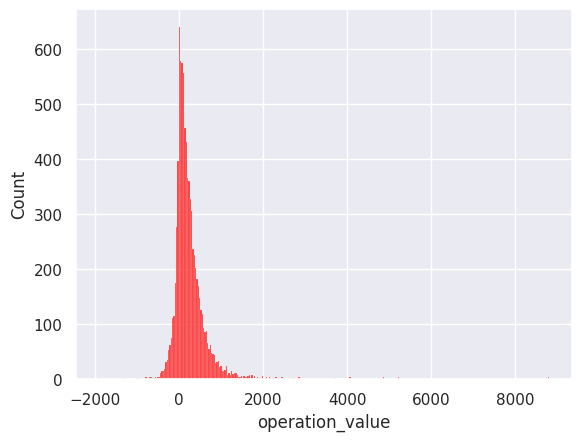

In [8]:
sns.histplot(data=df['operation_value'], palette = 'deep', color='red')

Распределение имеет правостороннюю ассиметрию и островершинность. Даже на глаз видно большое количество выбросов.

In [9]:
from etna.datasets import TSDataset

In [10]:
df_etna = df.copy(deep=True)
df_etna['timestamp'] =  pd.to_datetime(df_etna['datetime'])
df_etna["segment"] = df_etna["atm_id"]
df_etna["target"] = df_etna["operation_value"]
df_etna.drop(columns=["operation_value", "atm_id","datetime"], inplace=True)

df_etna.head()

,timestamp,segment,target
0,2017-08-16,74,2.059266
1,2017-08-17,74,1.029633
2,2017-08-18,74,0.686422
3,2017-08-19,74,33.301267
4,2017-08-20,74,-12.237921


In [11]:
ts = TSDataset(df_etna, freq="D")
ts

segment,100,101,102,103,104,105,106,74,85,86,87,88,90,91,93,94,96,97,98,99
feature,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target
timestamp,,,,,,,,,,,,,,,,,,,,
2017-06-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.617780,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.441486,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.235345,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-13.532317,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.398647,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-09-26,489.428602,-161.446425,-151.650204,677.704316,114.818767,160.505046,2.794718,2297.228473,348.074726,120.378785,430.162938,511.345072,69.338415,243.022761,844.916685,517.022761,-114.083315,739.570539,547.176294,187.216663
2018-09-27,-239.492592,-438.800086,398.467898,953.351729,568.916255,836.297187,-106.787632,1693.304703,846.975950,367.520077,420.081361,382.935151,351.575478,374.727507,199.748765,753.397037,504.549495,-264.350870,-235.609405,560.208503


In [12]:
ts.info()

<class 'etna.datasets.TSDataset'>
num_segments: 20
num_exogs: 0
num_regressors: 0
num_known_future: 0
freq: D
         start_timestamp end_timestamp  length  num_missing
segments                                                   
100           2017-08-11    2018-09-30     416            3
101           2017-08-11    2018-09-30     416            3
102           2017-08-02    2018-09-30     425            3
103           2017-08-08    2018-09-30     419            3
104           2017-08-07    2018-09-30     420            3
105           2017-07-28    2018-09-30     430            3
106           2017-08-09    2018-09-30     418            3
74            2017-08-16    2018-09-30     411            3
85            2017-08-03    2018-09-30     424            3
86            2017-08-01    2018-09-30     426            3
87            2017-06-09    2018-09-30     479            3
88            2017-08-14    2018-09-30     413            3
90            2017-07-27    2018-09-30     431    

In [13]:
ts.describe()

,start_timestamp,end_timestamp,length,num_missing,num_segments,num_exogs,num_regressors,num_known_future,freq
segments,,,,,,,,,
100,2017-08-11,2018-09-30,416,3,20,0,0,0,D
101,2017-08-11,2018-09-30,416,3,20,0,0,0,D
102,2017-08-02,2018-09-30,425,3,20,0,0,0,D
103,2017-08-08,2018-09-30,419,3,20,0,0,0,D
104,2017-08-07,2018-09-30,420,3,20,0,0,0,D
105,2017-07-28,2018-09-30,430,3,20,0,0,0,D
106,2017-08-09,2018-09-30,418,3,20,0,0,0,D
74,2017-08-16,2018-09-30,411,3,20,0,0,0,D
85,2017-08-03,2018-09-30,424,3,20,0,0,0,D


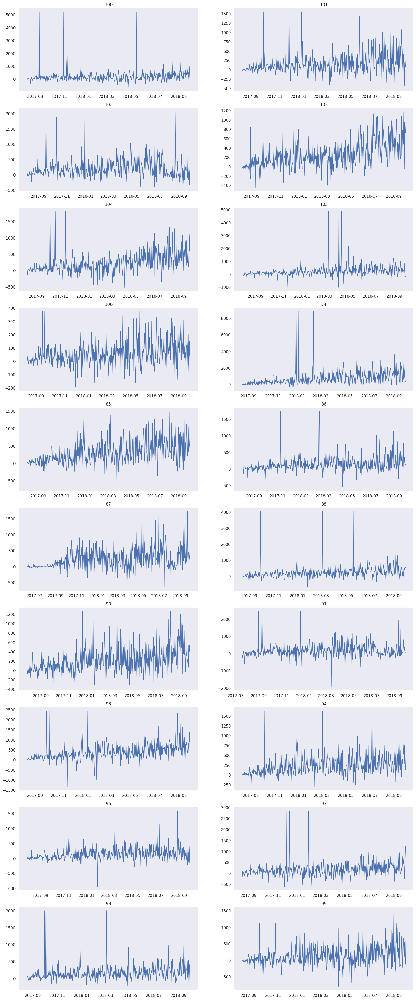

In [ ]:
ts.plot(n_segments = 20)

Почти во всех представленных рядах отслеживаются аномалии (как положительные, так и отрицательные). В большинстве из рядов визуально тренд отсутствует (предположительно имеется позитивный тренд у рядов 103, 104 и 106). Можно предположить, что для всех рядов наблюдается сезонность. Для более подробного анализа посмотрим на статистики рядов:

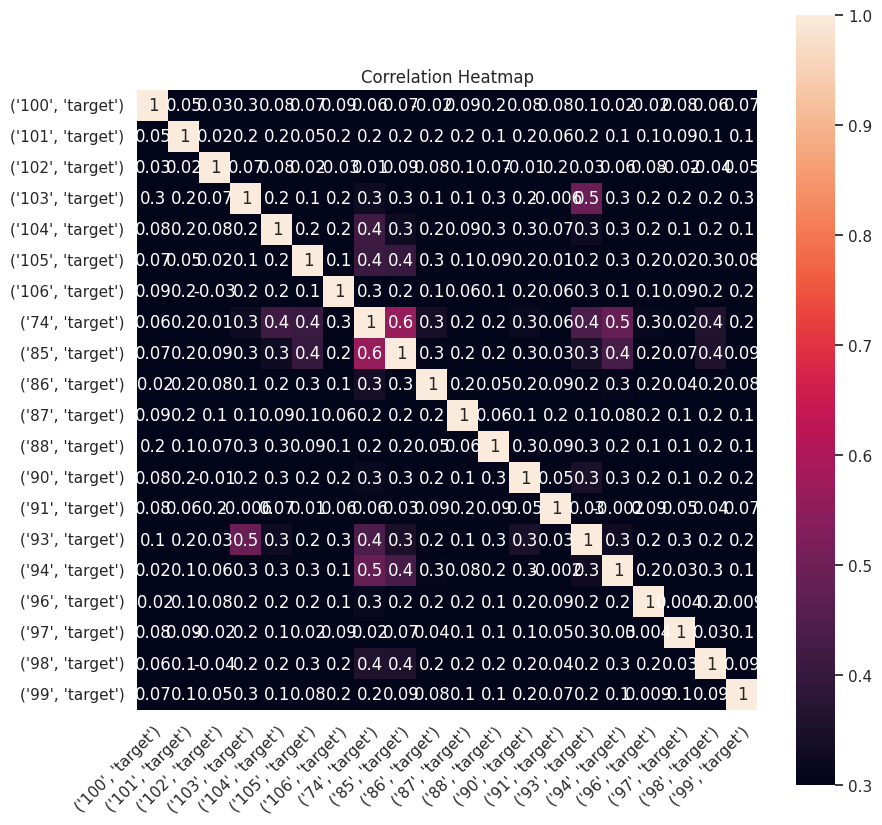

In [ ]:
plot_correlation_matrix(ts, method="spearman", vmin=0.3, vmax=1)

Ряды друг на друга практически не влияют (большинство корреляций между ними меньше 0,3).  Наибольшая корреляция наблдюается между 74 и 85 банкоматом (равна 0.6).

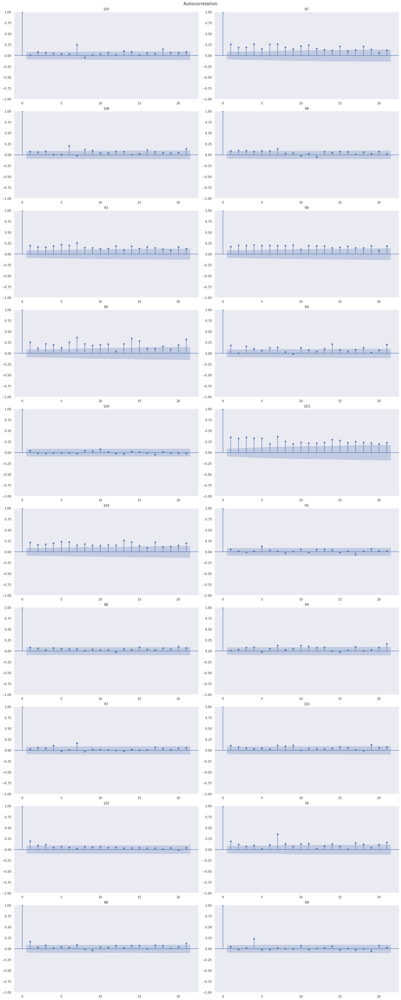

In [ ]:
acf_plot(ts, lags=21, n_segments = 20)

Выводы по графикам автрегрессии:
1) У 74 и 105 банкоматов наблдюается недельная сезонность
2) У 87, 93, 90, 85, 103 и 104 банкоматов авторегрессия остается высокая на протяжении большого количества лагов, что может говорить  том, что этим временным рядам может свойственна модель авторегрессии. Для подтверждения нужно посмотреть график частной автокрреляции.


In [ ]:
df_etna2 = df_etna[df_etna['timestamp'] >= '2017-08-17']
ts2 = TSDataset(df_etna2.dropna(), freq="D")
ts2

segment,100,101,102,103,104,105,106,74,85,86,87,88,90,91,93,94,96,97,98,99
feature,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target
timestamp,,,,,,,,,,,,,,,,,,,,
2017-08-17,-1.000215,6.501396,58.600816,-43.097488,-12.620356,48.981104,5.324673,1.029633,33.418939,36.007730,56.894567,-1.235559,109.405841,20.533820,15.768091,-6.648486,39.214301,-153.591797,9.472622,-5.442345
2017-08-18,-6.707322,-13.502899,91.284303,-11.473051,-22.416577,204.896929,-12.414430,0.686422,41.273567,-17.062487,7.325102,41.450075,-32.271634,186.922482,-6.089543,31.742109,-9.178441,-72.927421,70.926992,-59.042087
2017-08-19,-12.914537,-11.296543,211.957269,42.332618,40.626369,-14.208933,-27.652995,33.301267,7.678119,NaN,2.794718,15.738673,6.089543,-17.680266,15.260629,8.825424,22.328323,59.630449,43.332832,-47.186601
2017-08-20,-354.399613,-30.947820,33.477775,51.658149,82.473588,18.062701,3.942023,-12.237921,58.365471,54.864720,-4.765729,21.298690,79.634743,-151.709040,13.565004,-6.589650,-14.091260,22.034142,-26.388018,21.681125
2017-08-21,-3.942023,26.946962,-0.764870,1.412068,-42.185527,-1.441486,18.415718,3.853769,44.303629,42.244363,34.007301,29.829933,-5.736526,160.152029,12.208503,40.185098,33.389521,-37.978742,-59.012669,-42.626798
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-09-26,489.428602,-161.446425,-151.650204,677.704316,114.818767,160.505046,2.794718,2297.228473,348.074726,120.378785,430.162938,511.345072,69.338415,243.022761,844.916685,517.022761,-114.083315,739.570539,547.176294,187.216663
2018-09-27,-239.492592,-438.800086,398.467898,953.351729,568.916255,836.297187,-106.787632,1693.304703,846.975950,367.520077,420.081361,382.935151,351.575478,374.727507,199.748765,753.397037,504.549495,-264.350870,-235.609405,560.208503


ValueError: There is a NaN in the middle of the time series!

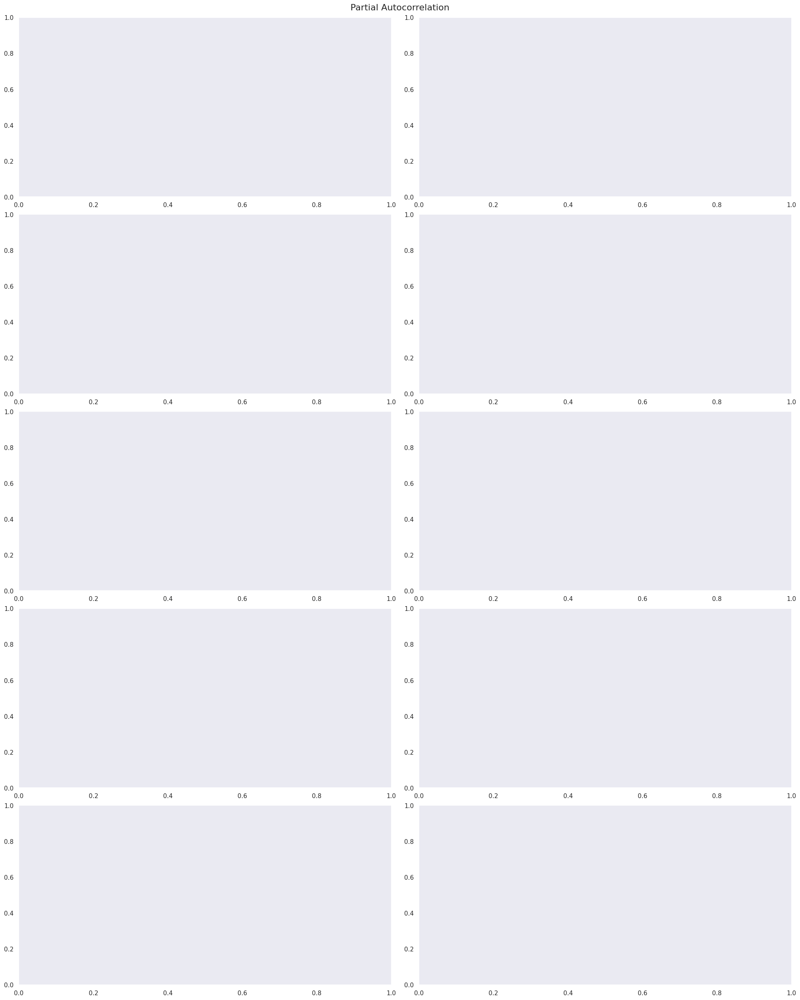

In [ ]:
acf_plot(ts2, partial=True,  lags=10)

In [ ]:
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.graphics.tsaplots import plot_pacf

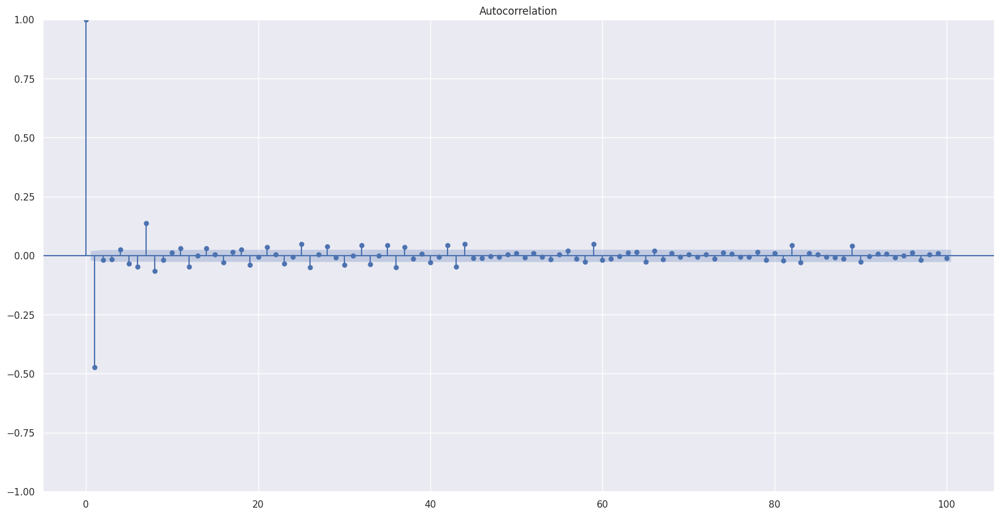

In [ ]:
fig, ax = plt.subplots(figsize=(20, 10))
plot_acf(df_etna['target'].diff().dropna(), lags=100, ax=ax)
plt.show()

In [ ]:
from etna.analysis import plot_trend
from etna.transforms import LinearTrendTransform

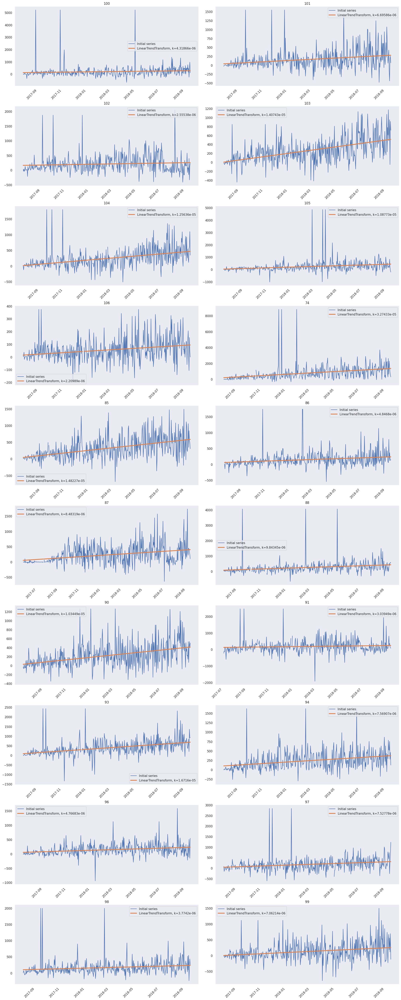

In [ ]:
plot_trend(ts, trend_transform=LinearTrendTransform(in_column="target"))

У рядов 101, 103, 104, 106,74,85,90,93,94 имеется положительный тренд, а у остальных рядов тренд практически отсутствует.

**Сезонность**
Выше по графикам мы сделали предположение о недельной сезонности, проверим нашу гипотезу с помощью декомпозиции STL

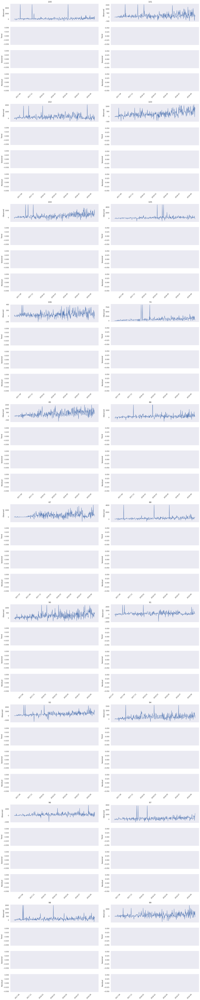

In [ ]:
stl_plot(ts=ts, period=52)

Ни у одноного банкомата недельной сезонности нет :(
  При проверке других периодов сезонности, она такжне обнаружена не была

### Задание 2. Работа с пропущенными значениями и выбросами (1 балл)

Проанализируйте, есть ли в данных пропущенные значения, и подберите оптимальный метод их заполнения средствами ETNA. Какие методы вы выберете и почему? Совет: возможно, лучше сохранить заполненные данные в отдельный объект, поскольку некоторые модели заполняют пропуски встроенными методами, и подача на вход "сырых" данных (на языке временных рядов это данные с нерегулярными интервалами) может принести лучший результат.

Импорты всех необходимых компонент произведите самостоятельно.

In [ ]:
ts.info()

<class 'etna.datasets.TSDataset'>
num_segments: 20
num_exogs: 0
num_regressors: 0
num_known_future: 0
freq: D
         start_timestamp end_timestamp  length  num_missing
segments                                                   
100           2017-08-11    2018-09-30     416            3
101           2017-08-11    2018-09-30     416            3
102           2017-08-02    2018-09-30     425            3
103           2017-08-08    2018-09-30     419            3
104           2017-08-07    2018-09-30     420            3
105           2017-07-28    2018-09-30     430            3
106           2017-08-09    2018-09-30     418            3
74            2017-08-16    2018-09-30     411            3
85            2017-08-03    2018-09-30     424            3
86            2017-08-01    2018-09-30     426            3
87            2017-06-09    2018-09-30     479            3
88            2017-08-14    2018-09-30     413            3
90            2017-07-27    2018-09-30     431    

Проверьте ряды на наличие выбросов, и очистите их соответствующим образом. Обоснуйте выбор.

Так как сезонности обнаружено не было, заполним пропуски c помощью  moving average  

In [14]:
from etna.transforms import (TimeSeriesImputerTransform,
                             DensityOutliersTransform,
                             MedianOutliersTransform)
from etna.analysis.outliers import (get_anomalies_density,
                                    get_anomalies_median,
                                    get_anomalies_prediction_interval)
from etna.analysis import (plot_anomalies, plot_anomalies_interactive,
                           plot_backtest, plot_forecast)
from etna.models import ProphetModel

In [15]:
nans_imputer = TimeSeriesImputerTransform(
    in_column="target", strategy="running_mean"
)

# df_etna_wo_na = nans_imputer.fit_transform(df_etna)
# ts_wo_na = TSDataset(df_etna_wo_na, freq="D")


ts_wo_na = deepcopy(ts)
ts_wo_na.fit_transform([nans_imputer])

In [ ]:
ts_wo_na.info()

<class 'etna.datasets.TSDataset'>
num_segments: 20
num_exogs: 0
num_regressors: 0
num_known_future: 0
freq: D
         start_timestamp end_timestamp  length  num_missing
segments                                                   
100           2017-08-11    2018-09-30     416            0
101           2017-08-11    2018-09-30     416            0
102           2017-08-02    2018-09-30     425            0
103           2017-08-08    2018-09-30     419            0
104           2017-08-07    2018-09-30     420            0
105           2017-07-28    2018-09-30     430            0
106           2017-08-09    2018-09-30     418            0
74            2017-08-16    2018-09-30     411            0
85            2017-08-03    2018-09-30     424            0
86            2017-08-01    2018-09-30     426            0
87            2017-06-09    2018-09-30     479            0
88            2017-08-14    2018-09-30     413            0
90            2017-07-27    2018-09-30     431    

Отклонение от медианных значений, рассчитанных по окну

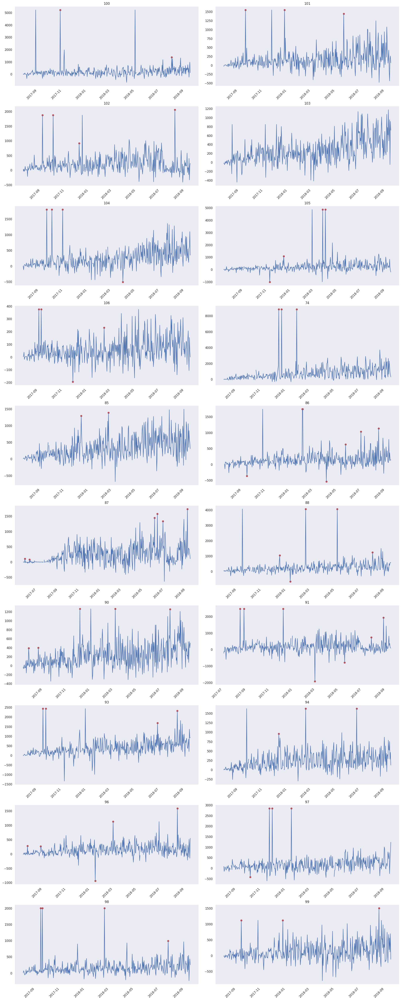

In [ ]:
anomaly_dict = get_anomalies_median(ts, window_size=50)  # задаем размер окна
plot_anomalies(ts, anomaly_dict)

Метод на основе плотности точек

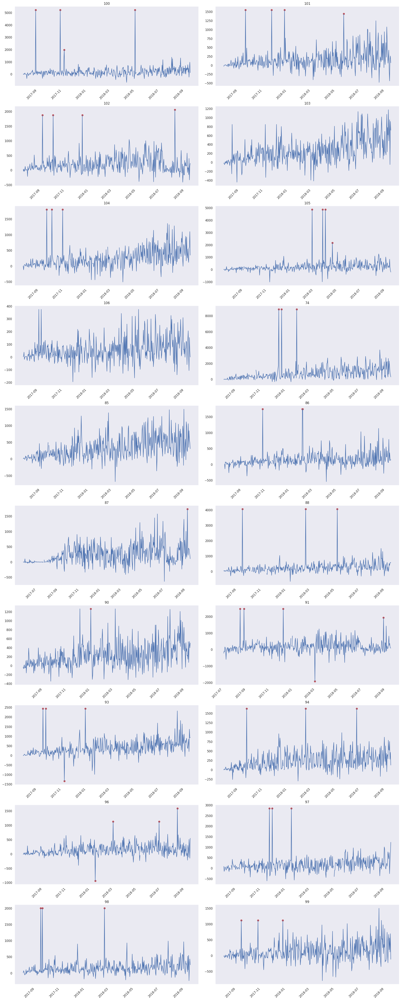

In [ ]:
anomaly_dict = get_anomalies_density(ts, window_size=18, distance_coef=3, n_neighbors=4)
plot_anomalies(ts, anomaly_dict)

Метод на основе предсказаний модели

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpqv3cd5tf/ug1ph4fy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpqv3cd5tf/gvtvlt2y.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=70212', 'data', 'file=/tmp/tmpqv3cd5tf/ug1ph4fy.json', 'init=/tmp/tmpqv3cd5tf/gvtvlt2y.json', 'output', 'file=/tmp/tmpqv3cd5tf/prophet_model1arrwx_3/prophet_model-20240526171017.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
17:10:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
17:10:18 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling yearly seasonalit

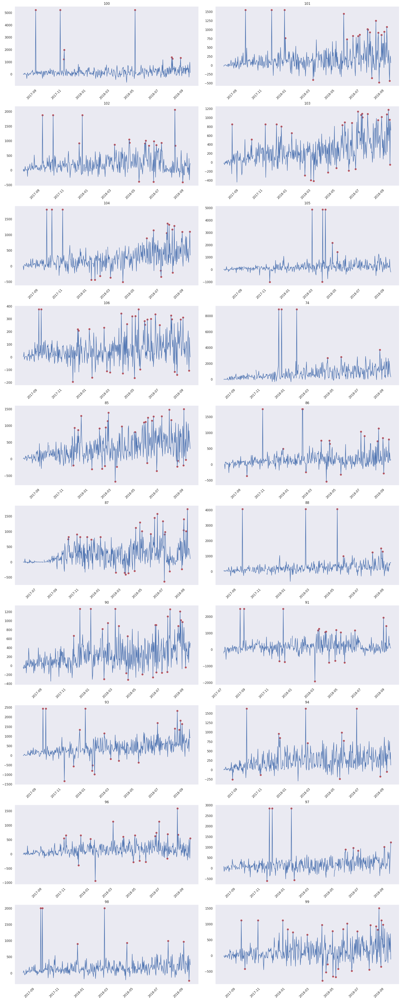

In [ ]:
anomaly_dict = get_anomalies_prediction_interval(ts, model=ProphetModel, interval_width=0.95)

plot_anomalies(ts, anomaly_dict)

Для идентификации выбросов будем использовать метод на основе плотности точек, так как визуально он лучше определяет выбросы. Для заполнения пропусков будем использовать также скользящее среднее, так как оно более локально определяет нужное значение и не подвержено влиянию значений, сильно отдаленных от рассматриваемого пропуска.

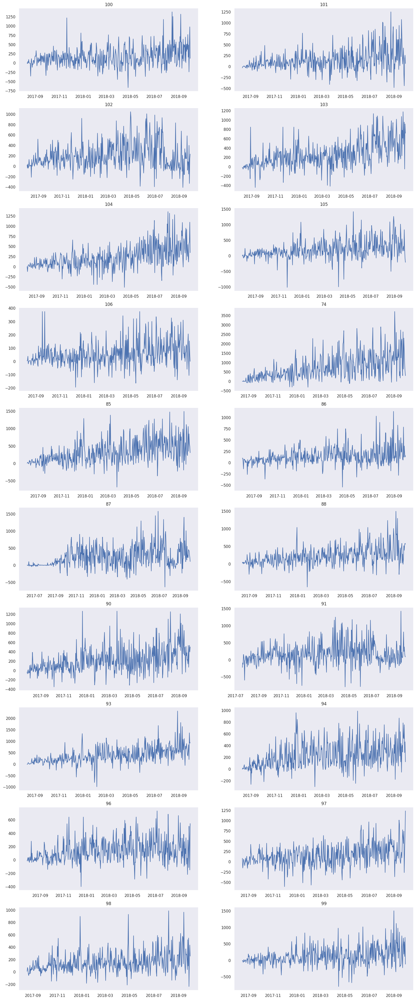

In [16]:
ts_filled_na = deepcopy(ts)

ts_filled_na.fit_transform([
    DensityOutliersTransform(in_column="target",  window_size=18, distance_coef=3, n_neighbors=4),
    TimeSeriesImputerTransform(strategy='running_mean'),
])

ts_filled_na.plot(n_segments=20)

теперь круто 😎

### Задание 3. Построение Prophet (1.25 балла)

Постройте прогнозы с помощью Prophet и `etna.Pipeline`, под капотом `etna.Pipeline` обучит `ProphetModel` для каждого сегмента в отдельности. После этого оцените качество по SMAPE на кросс-валидации. В качестве горизонта предсказания возьмите 5 дней - этого же горизонта будем придерживаться и в дальнейшем.

Отрисуйте получившийся прогноз.

In [17]:
from etna.pipeline import Pipeline
from etna.models import ProphetModel
from etna.metrics import SMAPE, MAE
from etna.analysis import plot_backtest

In [18]:
HORIZON = 5

In [19]:
model = ProphetModel()
transforms = []
pipeline = Pipeline(model=model, transforms=transforms, horizon=HORIZON)

metrics_df, forecast_df, fold_info_df = pipeline.backtest(
    ts=ts_filled_na, metrics=[SMAPE(), MAE()], n_jobs=5
)

metrics_df.groupby(['segment']).mean()

[Parallel(n_jobs=5)]: Using backend MultiprocessingBackend with 5 concurrent workers.
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp4qqo81jc/ekkrholb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp4qqo81jc/rfqpkp44.json
DEBUG:cmdstanpy:idx 0
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
DEBUG:cmdstanpy:running CmdStan, num_threads: None
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin'

,SMAPE,MAE,fold_number
segment,,,
100,83.139083,277.106941,2.0
101,88.171224,289.667411,2.0
102,96.604830,217.367221,2.0
103,58.706169,281.733346,2.0
104,52.763788,249.705295,2.0
105,82.797452,251.323585,2.0
106,86.283698,74.094500,2.0
74,55.805483,595.957711,2.0
85,55.508331,262.322377,2.0


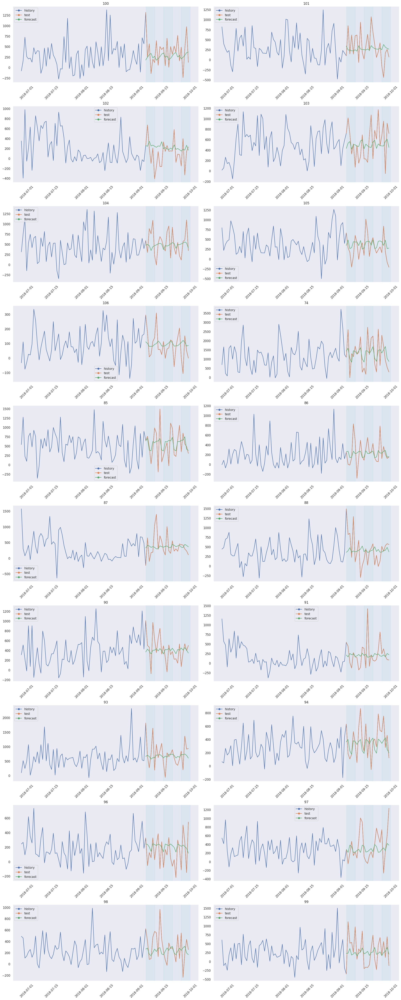

In [20]:
plot_backtest(forecast_df, ts_filled_na, history_len=70)

Исходя из статистики по каждому ряду, какой можно сделать вывод о том, как лучше предсказывать итоговое значение? Посчитайте то же самое исходя из MAE.

Cчитала сразу для SWAPE и MAE, лучше считать по SWAPE

### Задание 4. Иерархический временной ряд (2 балла)

Вопрос, поставленный в прошлом задании, тем не менее, естественным образом подводит нас к концепции **иерархического временного ряда** (когда один ряд состоит из других в качестве компонент). Это полезная концепция, которая может встретиться во многих задачах. В этом задании вам предстоит самостоятельно разобраться в деталях ее реализации в ETNA с использованием справочных материалов, предоставляемых библиотекой (как это часто бывает на практике). Они содержатся по следующей ссылке:

https://github.com/etna-team/etna/blob/master/examples/303-hierarchical_pipeline.ipynb

На выходе из первой части задания необходимо получить `TSDataset` с иерархической структурой, а также соответствующий реконсилятор, который позволит собирать искомый ряд из составных компонент. Классы, которые вам понадобятся, импортированы ниже.

In [21]:
from etna.datasets import HierarchicalStructure
from etna.pipeline import HierarchicalPipeline
from etna.reconciliation import TopDownReconciliator

In [22]:
segment = list(map(str, df_etna.segment.unique()))

hierarchical_structure = HierarchicalStructure(
    level_structure={"target": segment}, level_names=["target", "segment"]
)

hierarchical_ts = TSDataset(df=df_etna, freq="D", hierarchical_structure=hierarchical_structure)

hierarchical_ts.head()

segment,100,101,102,103,104,105,106,74,85,86,87,88,90,91,93,94,96,97,98,99
feature,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target
timestamp,,,,,,,,,,,,,,,,,,,,
2017-06-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.617780,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.441486,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.235345,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-13.532317,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.398647,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
hierarchical_ts.current_df_level

'segment'

TopDownReconciliator не может работать с отрицательными числами, поэтому прибавим константу

In [ ]:
df_etna['target'].min()

-1925.2956839167

In [23]:
df_etna1 = df_etna.copy()
df_etna1['target'] = df_etna1['target'] + 1926
df_etna1.head()

,timestamp,segment,target
0,2017-08-16,74,1928.059266
1,2017-08-17,74,1927.029633
2,2017-08-18,74,1926.686422
3,2017-08-19,74,1959.301267
4,2017-08-20,74,1913.762079


In [24]:
segment = list(map(str, df_etna1.segment.unique()))

hierarchical_structure1 = HierarchicalStructure(
    level_structure={"target": segment}, level_names=["target", "segment"]
)

hierarchical_ts1 = TSDataset(df=df_etna1, freq="D", hierarchical_structure=hierarchical_structure1)

hierarchical_ts1.head()

segment,100,101,102,103,104,105,106,74,85,86,87,88,90,91,93,94,96,97,98,99
feature,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target
timestamp,,,,,,,,,,,,,,,,,,,,
2017-06-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1926.617780,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1927.441486,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1925.764655,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1912.467683,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1933.398647,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [25]:
ahp_reconciliator = TopDownReconciliator(
    target_level="segment", source_level="target", method="AHP", period=6
)

ahp_reconciliator.fit(ts=hierarchical_ts1)
ahp_reconciliator.mapping_matrix.toarray()

array([[0.06478029],
       [0.05456108],
       [0.04792581],
       [0.04858187],
       [0.05138363],
       [0.05025735],
       [0.04802202],
       [0.05911235],
       [0.05121093],
       [0.04615623],
       [0.05254582],
       [0.04623642],
       [0.04914019],
       [0.04864145],
       [0.04277404],
       [0.04293043],
       [0.05489579],
       [0.05223612],
       [0.04588366],
       [0.04272452]])

Во второй части задания примените найденные на предыдущих этапах преобразования очистку от выбросов уже к иерархическому датасету, и запустите на нем Prophet с MAE на кросс-валидации.

In [ ]:
hierarchical_ts1.fit_transform([
    DensityOutliersTransform(in_column="target",  window_size=18, distance_coef=3, n_neighbors=4),
    TimeSeriesImputerTransform(strategy='running_mean'),
])

In [27]:
model = ProphetModel()
transforms = []
pipeline = Pipeline(model=model, transforms=transforms, horizon=HORIZON)

metrics_df_hierh, forecast_df_hierh, fold_info_df_hierh = pipeline.backtest(
    ts=hierarchical_ts1, metrics=[MAE()], n_jobs=5
)

metrics_df_hierh.groupby(['segment']).mean()

[Parallel(n_jobs=5)]: Using backend MultiprocessingBackend with 5 concurrent workers.
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp4qqo81jc/cje2merp.json
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp4qqo81jc/7nukn41e.json
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=Tru

,MAE,fold_number
segment,,
100,272.099294,2.0
101,286.269304,2.0
102,205.220972,2.0
103,276.688319,2.0
104,249.062317,2.0
105,272.084886,2.0
106,76.291443,2.0
74,570.108657,2.0
85,262.042658,2.0


MAE снизилась для каждого сегмента, иерархическая структура имеет место быть

### Задание 5. Построение признаков (1.5 балла)

Вернемся к нашему исходному мультисегментному ряду - теперь поработаем с моделями, которые требуют построения признаков - `ARIMA` и `CatBoost`. Построим для них признаки, и попробуем при помощи них добиться улучшения качества.

Из обязательного:
1) постройте графики автокорреляции и при помощи них обоснуйте выбор лаговых признаков
2) для катбуста включите в признаки результаты STL разложения. STL используем для убирания тренда за счет преобразования на месте.
* Кроме этого, подумайте на экспертном уровне,
    - Какие еще закономерности могут присутствовать и почему?
    - Что из этого кажется более предсказуемым, и почему?
    - Cделайте соответствующие признаки, и снабдите их кратким комментарием.

3) После этого, обучите на получившихся признаках модели. Для `CatBoost` рассмотрите 2 версии мультисегментную и на каждый ряд в отдельности.

Ниже приведены импорты, которые вам точно понадобятся - к ним необходимо добавить те инструменты, которые вы дополнительно решите использовать в анализе.

In [28]:
from etna.analysis import acf_plot, stl_plot
from etna.ensembles import DirectEnsemble, StackingEnsemble, VotingEnsemble
from etna.models import (CatBoostMultiSegmentModel, CatBoostPerSegmentModel,
                         AutoARIMAModel)
from etna.transforms import STLTransform, LagTransform, SegmentEncoderTransform, DateFlagsTransform

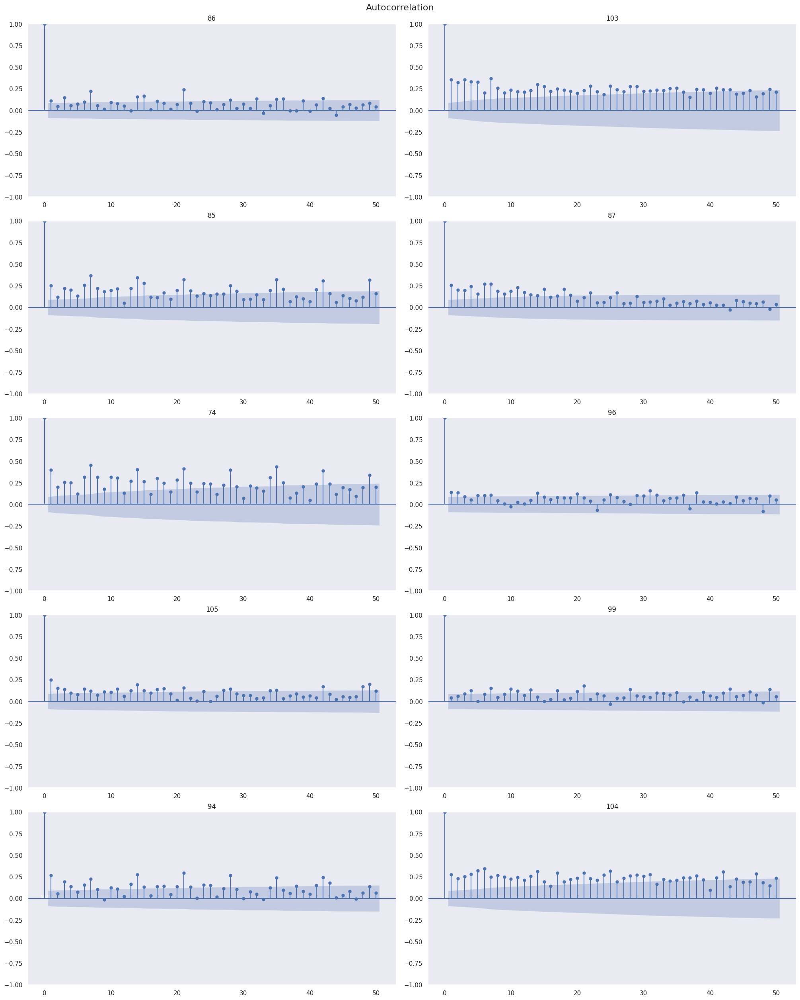

In [31]:
acf_plot(ts_filled_na, lags=50)

По ACF видно, что пристутствуют статистически значимые автокорелляции с наблюдениями вплоть до 30 лага почти по всем банкоматам. При этом для болльшинства банкоматов наблюдается увеличение коэффициента корреляции на 6,7 лагах

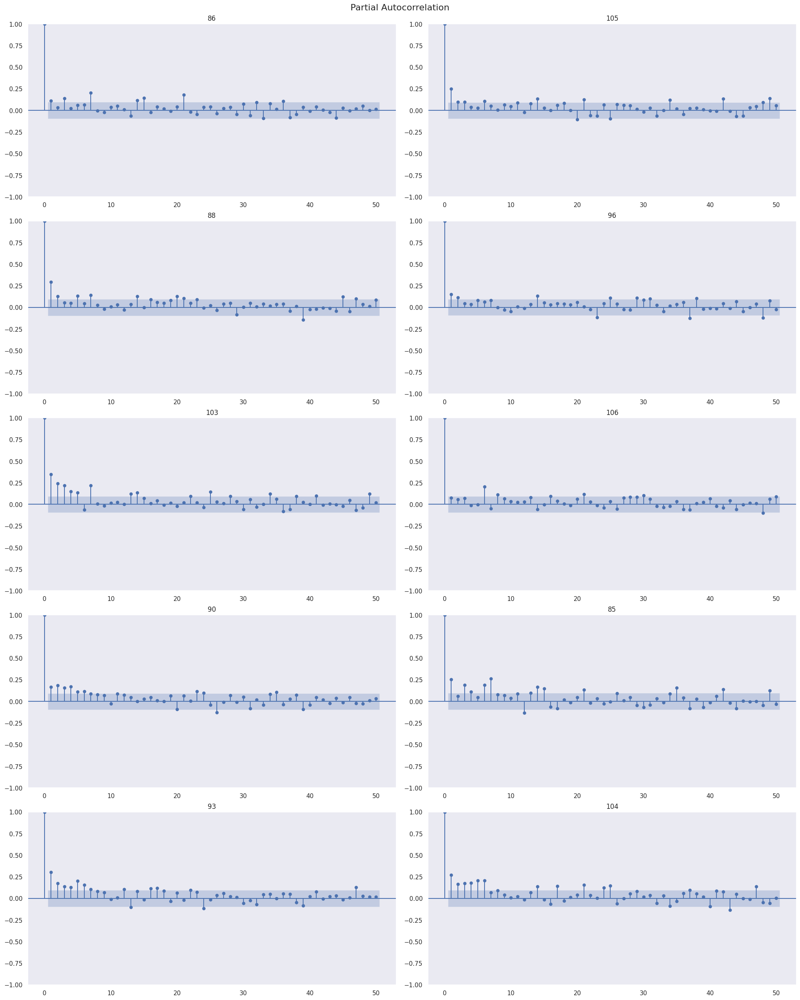

In [32]:
acf_plot(ts_filled_na, partial = True, lags=50)

По графикам видно, что переменная имеет положительную частную корелляцию с 1, 6 и 7 лагам.

ARIMA

In [33]:
model = AutoARIMAModel()
lags = LagTransform(in_column="target", lags=[6, 7])

transforms = [lags]
pipeline = Pipeline(model=model, transforms=transforms, horizon=HORIZON)

metrics_df, forecast_df, fold_info_df = pipeline.backtest(
    ts=ts_filled_na, metrics=[SMAPE(), MAE()], n_jobs=5
)

[Parallel(n_jobs=5)]: Using backend MultiprocessingBackend with 5 concurrent workers.
[Parallel(n_jobs=5)]: Done   1 tasks      | elapsed: 30.4min
[Parallel(n_jobs=5)]: Done   2 out of   5 | elapsed: 31.6min remaining: 47.4min
[Parallel(n_jobs=5)]: Done   3 out of   5 | elapsed: 31.7min remaining: 21.1min
[Parallel(n_jobs=5)]: Done   5 out of   5 | elapsed: 33.1min finished
[Parallel(n_jobs=5)]: Using backend MultiprocessingBackend with 5 concurrent workers.
[Parallel(n_jobs=5)]: Done   1 tasks      | elapsed:   19.0s
[Parallel(n_jobs=5)]: Done   2 out of   5 | elapsed:   19.9s remaining:   29.9s
[Parallel(n_jobs=5)]: Done   3 out of   5 | elapsed:   21.2s remaining:   14.2s
[Parallel(n_jobs=5)]: Done   5 out of   5 | elapsed:   22.6s finished
[Parallel(n_jobs=5)]: Using backend MultiprocessingBackend with 5 concurrent workers.
[Parallel(n_jobs=5)]: Done   1 tasks      | elapsed:    1.7s
[Parallel(n_jobs=5)]: Done   2 out of   5 | elapsed:    3.0s remaining:    4.5s
[Parallel(n_jobs=5)

In [34]:
metrics_df.groupby(['segment']).mean()

,SMAPE,MAE,fold_number
segment,,,
100,79.719319,263.962786,2.0
101,88.481936,292.297241,2.0
102,125.801529,212.786030,2.0
103,58.152617,276.506883,2.0
104,53.904346,257.015215,2.0
105,82.794225,258.262920,2.0
106,89.295403,80.621244,2.0
74,60.687348,649.880293,2.0
85,59.670163,281.735867,2.0


CatBoost

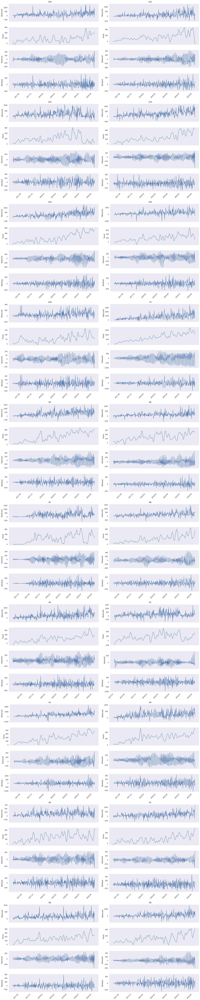

In [36]:
stl_plot(ts=ts_filled_na, period=7)

In [37]:
stl = STLTransform(in_column="target", period=7, model="arima")
transformed_train_ts = deepcopy(ts_filled_na)
transformed_train_ts.fit_transform([stl])

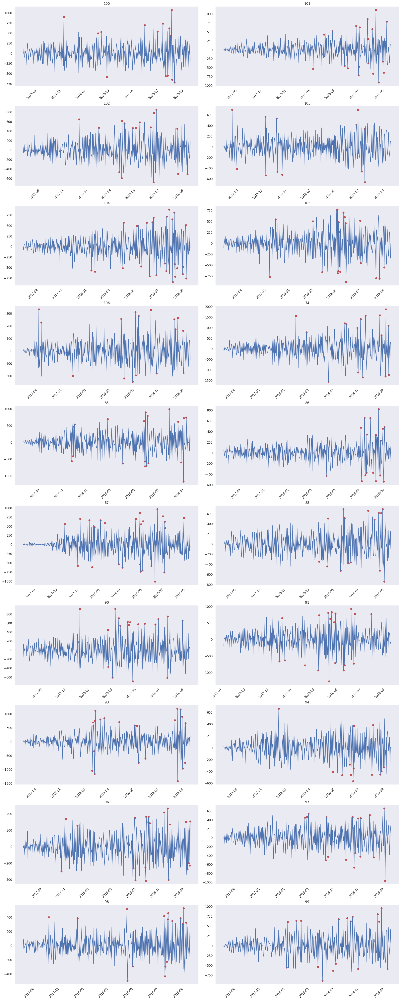

In [38]:
plot_anomalies(
    ts=transformed_train_ts,
    anomaly_dict=get_anomalies_density(ts=transformed_train_ts, window_size=5, distance_coef=2.5),
)

In [39]:
stl = STLTransform(in_column="target", period=7, model="arima")
model = CatBoostMultiSegmentModel()
anomaly = DensityOutliersTransform(in_column="target", window_size=5, distance_coef=2.5)
seg = SegmentEncoderTransform()

transforms = [stl, anomaly, seg]
pipeline = Pipeline(model=model, transforms=transforms, horizon=HORIZON)

metrics_df, forecast_df, fold_info_df = pipeline.backtest(
    ts=ts_filled_na, metrics=[SMAPE(), MAE()], n_jobs=5
)

metrics_df.groupby(['segment']).mean()

[Parallel(n_jobs=5)]: Using backend MultiprocessingBackend with 5 concurrent workers.
[Parallel(n_jobs=5)]: Done   1 tasks      | elapsed:   45.8s
[Parallel(n_jobs=5)]: Done   2 out of   5 | elapsed:   46.3s remaining:  1.2min
[Parallel(n_jobs=5)]: Done   3 out of   5 | elapsed:   47.1s remaining:   31.4s
[Parallel(n_jobs=5)]: Done   5 out of   5 | elapsed:   50.2s finished
[Parallel(n_jobs=5)]: Using backend MultiprocessingBackend with 5 concurrent workers.
[Parallel(n_jobs=5)]: Done   1 tasks      | elapsed:   36.3s
[Parallel(n_jobs=5)]: Done   2 out of   5 | elapsed:   37.6s remaining:   56.4s
[Parallel(n_jobs=5)]: Done   3 out of   5 | elapsed:   40.0s remaining:   26.7s
[Parallel(n_jobs=5)]: Done   5 out of   5 | elapsed:   41.8s finished
[Parallel(n_jobs=5)]: Using backend MultiprocessingBackend with 5 concurrent workers.
[Parallel(n_jobs=5)]: Done   1 tasks      | elapsed:    1.5s
[Parallel(n_jobs=5)]: Done   2 out of   5 | elapsed:    2.4s remaining:    3.6s
[Parallel(n_jobs=5)

,SMAPE,MAE,fold_number
segment,,,
100,91.119394,329.101476,2.0
101,115.984575,403.234561,2.0
102,152.328807,407.823857,2.0
103,80.047159,381.258752,2.0
104,73.476593,364.577673,2.0
105,108.028345,303.823191,2.0
106,115.282235,118.530044,2.0
74,70.775465,820.674189,2.0
85,78.079336,385.204635,2.0


from matplotlib import pyplot as plt
_df_0['SMAPE'].plot(kind='hist', bins=20, title='SMAPE')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_1['MAE'].plot(kind='hist', bins=20, title='MAE')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_2.plot(kind='scatter', x='SMAPE', y='MAE', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['fold_number']
  ys = series['SMAPE']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_3.sort_values('fold_number', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('fold_number')
_ = plt.ylabel('SMAPE')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['fold_number']
  ys = series['MAE']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_4.sort_values('fold_number', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('fold_number')
_ = plt.ylabel('MAE')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  counted = (series['fold_number']
                .value_counts()
              .reset_index(name='counts')
              .rename({'index': 'fold_number'}, axis=1)
              .sort_values('fold_number', ascending=True))
  xs = counted['fold_number']
  ys = counted['counts']
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_5.sort_values('fold_number', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('fold_number')
_ = plt.ylabel('count()')

from matplotlib import pyplot as plt
_df_6['SMAPE'].plot(kind='line', figsize=(8, 4), title='SMAPE')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
_df_7['MAE'].plot(kind='line', figsize=(8, 4), title='MAE')
plt.gca().spines[['top', 'right']].set_visible(False)

CatBoost для каждого сегмента

In [44]:
stl = STLTransform(in_column="target", period=7, model="arima")
model = CatBoostPerSegmentModel()
anomaly = DensityOutliersTransform(in_column="target", window_size=5, distance_coef=2.5)
seg = SegmentEncoderTransform()

transforms = [stl, anomaly, seg]
pipeline = Pipeline(model=model, transforms=transforms, horizon=HORIZON)

metrics_df, forecast_df, fold_info_df = pipeline.backtest(
    ts=ts_filled_na, metrics=[SMAPE(), MAE()], n_jobs=5
)

metrics_df.groupby(['segment']).mean()

[Parallel(n_jobs=5)]: Using backend MultiprocessingBackend with 5 concurrent workers.


CatBoostError: /src/catboost/catboost/libs/data/quantization.cpp:2420: All features are either constant or ignored.

Тут я затупила и попыталась написать катбуст для каждого сегмента руками из мультисегментного, забавы ради оставлю))

In [43]:
# import numpy as np

# stl = STLTransform(in_column="target", period=7, model="arima")
# model = CatBoostMultiSegmentModel()
# anomaly = DensityOutliersTransform(in_column="target", window_size=5, distance_coef=2.5)
# seg = SegmentEncoderTransform()

# transforms = [stl, anomaly, seg]
# pipeline = Pipeline(model=model, transforms=transforms, horizon=HORIZON)

# metrics = pd.DataFrame({'segment':df_etna.segment.unique(),
#                        'metrics':np.nan})

# for segment in df_etna.segment.unique():
#   metrics_df, forecast_df, fold_info_df = pipeline.backtest(
#       ts=ts_filled_na.get_segment(segment), metrics=[SMAPE(), MAE()], n_jobs=5
#   )
#   metrics.loc[df['segment'] = segment]['metrics'] = metrics_df.mean()

# metrics

SyntaxError: cannot assign to subscript here. Maybe you meant '==' instead of '='? (<ipython-input-43-a48b40838570>, line 18)

Метрики получились относительно высокими (относительно той же профет модели),можно еще попробовать добавить праздничные дни в качестве признаков, наверняка они влияют

In [45]:
holidays = [1,2,3,4,5,6,7, # new year
            54, # 23 feb
            67, 68, # 8 mar
            121,122,123,124,125,126,127,128,129,130, #may holidays
            163,164, #russia day
            308,309# день народного единства
           ]

In [46]:
stl = STLTransform(in_column="target", period=7, model="arima")
model = CatBoostMultiSegmentModel()
anomaly = DensityOutliersTransform(in_column="target", window_size=5, distance_coef=2.5)
seg = SegmentEncoderTransform()
d_flags = DateFlagsTransform(day_number_in_year=holidays)

transforms = [stl, anomaly, d_flags, seg]
pipeline = Pipeline(model=model, transforms=transforms, horizon=HORIZON)

metrics_df, forecast_df, fold_info_df = pipeline.backtest(
    ts=ts_filled_na, metrics=[SMAPE(), MAE()], n_jobs=5
)

metrics_df.groupby(['segment']).mean()

[Parallel(n_jobs=5)]: Using backend MultiprocessingBackend with 5 concurrent workers.
[Parallel(n_jobs=5)]: Done   1 tasks      | elapsed:  1.0min
[Parallel(n_jobs=5)]: Done   2 out of   5 | elapsed:  1.0min remaining:  1.5min
[Parallel(n_jobs=5)]: Done   3 out of   5 | elapsed:  1.0min remaining:   40.8s
[Parallel(n_jobs=5)]: Done   5 out of   5 | elapsed:  1.0min finished
[Parallel(n_jobs=5)]: Using backend MultiprocessingBackend with 5 concurrent workers.
[Parallel(n_jobs=5)]: Done   1 tasks      | elapsed:   26.5s
[Parallel(n_jobs=5)]: Done   2 out of   5 | elapsed:   27.6s remaining:   41.4s
[Parallel(n_jobs=5)]: Done   3 out of   5 | elapsed:   28.0s remaining:   18.7s
[Parallel(n_jobs=5)]: Done   5 out of   5 | elapsed:   29.1s finished
[Parallel(n_jobs=5)]: Using backend MultiprocessingBackend with 5 concurrent workers.
[Parallel(n_jobs=5)]: Done   1 tasks      | elapsed:    1.0s
[Parallel(n_jobs=5)]: Done   2 out of   5 | elapsed:    1.6s remaining:    2.4s
[Parallel(n_jobs=5)

,SMAPE,MAE,fold_number
segment,,,
100,93.026906,335.544335,2.0
101,106.970282,397.003756,2.0
102,150.272671,402.017334,2.0
103,77.400093,372.258550,2.0
104,72.356483,357.866135,2.0
105,104.838313,298.443784,2.0
106,109.417024,122.399815,2.0
74,71.612787,830.718493,2.0
85,78.119922,384.879678,2.0


Профет все равно лучше

### Задание 6. Стратегии прогнозирования (1.25 балла)

Как нам известно по семинарским занятиям, при построении прогноза на горизонте дальше следующего наблюдения перед нами встает задача определиться со стратегией генерации прогноза. Попробуйте разные стратегии на нашем горизонте из 5 дней (прямая, рекурсивная). Какая стратегия в совокупности с какой моделью дает лучший результат?

Учитывайте особенности, которые некоторые стратегии могут накладывать на признаки (в частности, на лаговые переменные).

При необходимости, в смешанном методе пользуйтесь упрощенной схемой спецификации моделей/преобразований.

In [47]:
from etna.pipeline import AutoRegressivePipeline, Pipeline, assemble_pipelines
from etna.ensembles import DirectEnsemble

In [49]:
stl = STLTransform(in_column="target", period=7, model="arima")
anomaly = DensityOutliersTransform(in_column="target", window_size=5, distance_coef=2.5)
lags = LagTransform(in_column="target", lags=[1, 6, 7])
d_flags = DateFlagsTransform(day_number_in_year=holidays)
seg = SegmentEncoderTransform()

AutoRegressivePipeline

In [50]:
model = ProphetModel()

transforms = [lags, anomaly, d_flags]

autoregressivepipeline = AutoRegressivePipeline(
    model=model, transforms=transforms, horizon=HORIZON, step=1
)

metrics_recursive_df, forecast_recursive_df, _ = autoregressivepipeline.backtest(
    ts=ts_filled_na,
    metrics=[SMAPE(), MAE()],
    n_jobs=3,
    n_folds=3
)

arp_metrics_prophet = metrics_recursive_df.groupby(['segment']).mean()
arp_metrics_prophet['method'] = 'ARP'
arp_metrics_prophet['Model'] = 'Prophet'

[Parallel(n_jobs=3)]: Using backend MultiprocessingBackend with 3 concurrent workers.
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp4qqo81jc/58bq7c4t.json
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp4qqo81jc/ha9sdr4o.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=63649', 'data', 'file=/tmp/tmp4qqo81jc/58bq7c4t.json', 'init=/tmp/tmp4qqo81jc/ha9sdr4o.json', 'output', 'file=/tmp/tmp4qqo81jc/prophet_model54vpq15s/prophet_model-20240526204340.csv', 

In [51]:
model = CatBoostMultiSegmentModel()

transforms = [stl, anomaly, d_flags, seg]

autoregressivepipeline = AutoRegressivePipeline(
    model=model, transforms=transforms, horizon=HORIZON, step=1
)

metrics_recursive_df, forecast_recursive_df, _ = autoregressivepipeline.backtest(
    ts=ts_filled_na,
    metrics=[SMAPE(), MAE()],
    n_jobs=3,
    n_folds=3
)

arp_metrics_cat = metrics_recursive_df.groupby(['segment']).mean()
arp_metrics_cat['method'] = 'ARP'
arp_metrics_cat['Model'] = 'Catboost'

[Parallel(n_jobs=3)]: Using backend MultiprocessingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done   1 tasks      | elapsed:   40.3s
[Parallel(n_jobs=3)]: Done   3 out of   3 | elapsed:   41.3s finished
[Parallel(n_jobs=3)]: Using backend MultiprocessingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done   1 tasks      | elapsed:  1.6min
[Parallel(n_jobs=3)]: Done   3 out of   3 | elapsed:  1.6min finished
[Parallel(n_jobs=3)]: Using backend MultiprocessingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done   1 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done   3 out of   3 | elapsed:    1.2s finished


Pipeline

In [52]:
model = ProphetModel()

lags_pipe = LagTransform(in_column="target", lags=[6,7])

transforms = [lags_pipe, anomaly, d_flags]

pipeline = Pipeline(model=model, transforms=transforms, horizon=HORIZON)

metrics_df, forecast_df, fold_info_df = pipeline.backtest(
    ts=ts_filled_na,
    metrics=[SMAPE(), MAE()],
    n_jobs=3,
    n_folds=3
)

pipe_metrics_prophet = metrics_df.groupby(['segment']).mean()
pipe_metrics_prophet['method'] = 'Pipeline'
pipe_metrics_prophet['Model'] = 'Prophet'

[Parallel(n_jobs=3)]: Using backend MultiprocessingBackend with 3 concurrent workers.
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp4qqo81jc/4raa3zni.json
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp4qqo81jc/ecrfe9ju.json
DEBUG:cmdstanpy:idx 0
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
DEBUG:cmdstanpy:running CmdStan, num_threads: None
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin'

In [53]:
model = CatBoostMultiSegmentModel()

transforms = [stl, anomaly, d_flags, seg]

pipeline = Pipeline(model=model, transforms=transforms, horizon=HORIZON)

metrics_df, forecast_df, fold_info_df = pipeline.backtest(
    ts=ts_filled_na,
    metrics=[SMAPE(), MAE()],
    n_jobs=3,
    n_folds=3
)

pipe_metrics_cat = metrics_df.groupby(['segment']).mean()
pipe_metrics_cat['method'] = 'Pipeline'
pipe_metrics_cat['Model'] = 'Catboost'

[Parallel(n_jobs=3)]: Using backend MultiprocessingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done   1 tasks      | elapsed:   37.6s
[Parallel(n_jobs=3)]: Done   3 out of   3 | elapsed:   38.3s finished
[Parallel(n_jobs=3)]: Using backend MultiprocessingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done   1 tasks      | elapsed:   16.8s
[Parallel(n_jobs=3)]: Done   3 out of   3 | elapsed:   17.6s finished
[Parallel(n_jobs=3)]: Using backend MultiprocessingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done   1 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done   3 out of   3 | elapsed:    1.2s finished


In [54]:
pipe_metrics_cat['method'][0]

'Pipeline'

In [55]:
df_metrics = [arp_metrics_prophet, arp_metrics_cat, pipe_metrics_prophet, pipe_metrics_cat]
res = pd.DataFrame()

for df in df_metrics:
    meth = df['method'][0]
    model = df['Model'][0]
    res[f'SMAPE_{meth}_{model}'] = df['SMAPE']
    # res[f'MAE_{meth}_{model}'] = df['MAE']

In [56]:
res

,SMAPE_ARP_Prophet,SMAPE_ARP_Catboost,SMAPE_Pipeline_Prophet,SMAPE_Pipeline_Catboost
segment,,,,
100,80.641107,100.168270,80.689646,100.168270
101,88.462720,99.771217,88.562952,99.771217
102,88.065578,143.268250,76.541843,143.268250
103,62.614050,56.497588,61.685890,56.497588
104,46.010148,74.723843,46.000746,74.723843
105,81.358887,89.607742,81.473443,89.607742
106,86.190814,118.814315,86.052063,118.814315
74,57.194764,63.881059,58.717429,63.881059
85,44.077444,63.074485,44.324623,63.074485


Почему-то для Catboost метрики получились одинаковые для обоих методов, а для Prophet лучше использовать Pipeline

### Задание 7. Ансамбли (1.25 балла)

Чтобы не выбирать лучшую модель, мы можем использовать преимущества каждой - давайте объединим все наши наработки в ансамбль. Попробуйте различные опции ансамблирования, и выберите ту, которая работает лучше всего (не забывайте, что внутри каждого ансамбля у нас тоже есть параметры, которые мы можем варьировать - веса в voting, включаемые признаки в stacking).

In [57]:
from etna.ensembles import StackingEnsemble, VotingEnsemble

In [ ]:
model = SeasonalMovingAverageModel(window=30, seasonality=7)

transforms = []

pipeline = Pipeline(model=model, transforms=transforms, horizon=HORIZON)

metrics_df, forecast_df, fold_info_df = pipeline.backtest(
    ts=ts_filled_na,
    metrics=[SMAPE(), MAE()],
    n_jobs=5,
    n_folds=5
)

metrics_df.groupby(['segment']).mean()

In [ ]:
plot_backtest(forecast_df, ts_wo_na, history_len=70)

В принципе SeasonalMovingAverageModel хорошо себя показывает исходя из метрик, поэтому ее тоже включим в ансамбль

In [ ]:
stl = STLTransform(in_column="target", period=7, model="arima")
anomaly = DensityOutliersTransform(in_column="target", window_size=5, distance_coef=2.5)
lags = LagTransform(in_column="target", lags=[6, 7])
d_flags = DateFlagsTransform(day_number_in_year=holidays)
seg = SegmentEncoderTransform()

In [ ]:
catboost_pipeline = Pipeline(
    model=CatBoostMultiSegmentModel(),
    transforms=[stl, anomaly, d_flags, seg],
    horizon=HORIZON,
)

seasonalma_pipeline = Pipeline(
    model=SeasonalMovingAverageModel(window=30, seasonality=7),
    transforms=[],
    horizon=HORIZON,
)

prophet_pipeline = Pipeline(
    model=ProphetModel(),
    transforms=[lags, anomaly, d_flags],
    horizon=HORIZON,
)

pipeline_names = ["catboost", "moving average", "prophet"]
pipelines = [catboost_pipeline, seasonalma_pipeline, prophet_pipeline]

In [ ]:
voting_ensemble = VotingEnsemble(pipelines=pipelines, weights=[1, 3, 6], n_jobs=4)

voting_ensamble_metrics, _, _ = voting_ensemble.backtest(
    ts=ts_filled_na,
    metrics=[MAE(), SMAPE()],
    n_folds=5,
    aggregate_metrics=True,
    n_jobs=5,
)

voting_ensamble_metrics

In [ ]:
stacking_ensemble = StackingEnsemble(
    pipelines=pipelines, n_folds=10, n_jobs=4, features_to_use='all'
)

stacking_ensemble_metrics, _, _ = stacking_ensemble.backtest(
    ts=ts_filled_na,
    metrics=[MAE(), SMAPE()],
    n_folds=5,
    aggregate_metrics=True,
    n_jobs=2,
)

stacking_ensemble_metrics

### Задание 8*. Трансформер (бонус 2 балла)

Для желающих протестировать мощь трансформенных моделей предлагается "завести" модель из второго семинара по временным рядам на текущем датасете. На этот раз абсолютно все необходимые импорты и зависимости подгружаются на ваше усмотрение. Удалось ли вам улучшить качество по сравнению с классическими моделями / моделями на основе ML? Что бы вы предпочли внедрить в production?

*NB:* все, конечно, прекрасно знают механизм работы бонусных заданий, но порядка ряди прописать дисклеймер должны - итоговый балл за домашнее задание ставится по формуле min(10, ваш суммарный балл за задания).

In [ ]:
#YOUR CODE HERE#